<a href="https://colab.research.google.com/github/StingrayS7/YOLOv11_Traffic_Signs_Detection-/blob/main/tsd.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Тема: Исследование производительности YOLO при детекции объектов в видеопотоке.

Исследование производительности YOLO при детекции объектов в видеопотоке играет ключевую роль в разработке систем реального времени.  Цель заключается в определении оптимального баланса между скоростью обработки и точностью обнаружения объектов. Анализ различных версий YOLO позволяет выявить их сильные и слабые стороны при работе с видеопотоком.



---



Цель:
Изучить производительность моделей YOLO11n, YOLO11s и  YOLO11l дообученных на датасете [VehicleDetection-YOLOv8](https://www.kaggle.com/datasets/alkanerturan/vehicledetection) при детекции объектов в видеопотоке.





---



# Загрузка и импорт библиотек

In [ ]:
# Установка необходимых библиотек
!pip install opencv-python ultralytics ipykernel > /dev/null 2>&1

In [ ]:
!pip install ruamel.yaml

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 117.7/117.7 kB 7.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 739.1/739.1 kB 3.1 MB/s eta 0:00:00


In [ ]:
import cv2

import os
import glob

import ultralytics
from ultralytics import YOLO
import time

import matplotlib.pyplot as plt
import numpy as np

import shutil

from moviepy.editor import *

ultralytics.checks()

Ultralytics 8.3.78 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
Setup complete ✅ (2 CPUs, 12.7 GB RAM, 33.2/112.6 GB disk)


In [ ]:
# подключение к google drive для сохранения и загрузки дообученных моделей
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# Теория



---



**Исследование производительности YOLO при детекции объектов в видеопотоке**

**Краткое описание проблемы:**

Основная проблема заключается в необходимости эффективного обнаружения объектов в видеопотоке в реальном времени. Это требует достижения баланса между скоростью обработки кадров и точностью обнаружения, особенно в условиях ограниченных вычислительных ресурсов. Различные версии YOLO демонстрируют разные характеристики производительности, что затрудняет выбор оптимального решения для конкретных задач.

**Основные концепции:**

YOLO (You Only Look Once) – это семейство алгоритмов обнаружения объектов, основанных на глубоких нейронных сетях. Ключевая идея YOLO заключается в однопроходном обнаружении объектов, что позволяет достичь высокой скорости обработки.  

**Основные концепции включают:**

**Разделение изображения на сетку:** Изображение делится на сетку, и для каждой ячейки сетки прогнозируются ограничивающие рамки и вероятности классов.

**Использование якорей (anchor boxes): **Якоря представляют собой предварительно заданные ограничивающие рамки, которые помогают модели прогнозировать размеры и формы объектов.

**Немаксимальное подавление (non-maximum suppression):** Этот метод используется для устранения перекрывающихся ограничивающих рамок и выбора наиболее уверенных обнаружений.



---



# Загрузка материалов

In [ ]:
# загрузка датасета
!wget 'https://drive.usercontent.google.com/download?id=1ZSKS0AdqAqpqU0ieVTZIRlON7iEwg2RD&export=download&authuser=1&confirm=t' -O './vehicle_detection.zip'

--2025-02-25 11:51:51--  https://drive.usercontent.google.com/download?id=1ZSKS0AdqAqpqU0ieVTZIRlON7iEwg2RD&export=download&authuser=1&confirm=t
Resolving drive.usercontent.google.com (drive.usercontent.google.com)... 74.125.200.132, 2404:6800:4003:c00::84
Connecting to drive.usercontent.google.com (drive.usercontent.google.com)|74.125.200.132|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 65822203 (63M) [application/octet-stream]
Saving to: ‘./vehicle_detection.zip’

./vehicle_detection 100%[===================>]  62.77M  51.0MB/s    in 1.2s    

2025-02-25 11:51:55 (51.0 MB/s) - ‘./vehicle_detection.zip’ saved [65822203/65822203]



In [ ]:
# извлечение датасета
!unzip -qo './vehicle_detection.zip'

In [ ]:
# директория yaml файла
yaml_path = './VehiclesDetectionDataset/dataset.yaml'

In [ ]:
# редактируем yaml файл чтобы не было конфликтов при обучении
import ruamel.yaml

yaml = ruamel.yaml.YAML()
yaml.indent(mapping=2, sequence=4, offset=2) #для корректного форматирования вывода


with open(yaml_path, 'r') as f:
    data = yaml.load(f)


# Сохраняем исходные пути
train_path = data.get('train')
val_path = data.get('val')
test_path = data.get('test')

# Устанавливаем новый путь
data['path'] = '../VehiclesDetectionDataset'

# Изменяем относительные пути, если они были заданы в формате ../path
if train_path and train_path.startswith("../"):
    data['train'] = train_path.replace("../", "")
if val_path and val_path.startswith("../"):
    data['val'] = val_path.replace("../", "")
if test_path and test_path.startswith("../"):
    data['test'] = test_path.replace("../", "")

with open(yaml_path, 'w') as f:
    yaml.dump(data, f)


# Доп функции

In [ ]:
# вывод результатов обучения
def result_train(path):
    '''
    @title: sdasd
    @param path: файл с результатом обучения
    '''
    img = cv2.imread(path)
    plt.figure(figsize=(10,10), dpi=200)
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB) # возвращаем изображение в rgb
    plt.imshow(img_rgb)

In [ ]:
# функция детекции видео
def video_detection(model, cap):
  '''
  @param model: модель YOLO
  @param cap: видеопоток VideoCapture
  @return: список со временем обработки кадров и список с количеством
  обнаруженных объектов
  '''

  frame_times = []
  detection_counts = []

  while True:
      start_time = time.time()
      ret, frame = cap.read()
      if not ret:
          break

      # Детекция объектов на кадре
      results = model(frame)

      end_time = time.time()
      frame_time = end_time - start_time
      frame_times.append(frame_time)
      detection_counts.append(len(results[0].boxes))

  return frame_times, detection_counts

In [ ]:
# вывод примеров детекции
def detect_sample(data_dir):
    """
    @param data_dir: диретория с результатами обучения
    """
    img_dir = os.path.join(data_dir, 'train_batch*.jpg')
    files = glob.glob(img_dir)
    imgs = []
    for image in files:
        result_train(image)

In [ ]:
# копирование модели
def transfer_model(source, destination, dirs_exist_ok=False):
    '''
    Копирует директорию модели в место назначения
    @param source: директория иодели, которую хотим перенести
    @param destination: место сохранения переносимой дериктории модели
    @param dirs_exist_ok: если True, то копирование продолжится, если встретятся уже существующие каталоги
    '''
    try:
        shutil.copytree(source, destination, dirs_exist_ok=False)
    except FileExistsError:
        print(f"Папка '{destination}' уже существует.")

In [ ]:
# Загрузка видеофайла
video_path = './TestVideo/TrafficPolice.mp4' # путь к тестовому видео
cap_11n = cv2.VideoCapture(video_path)
cap_11s = cv2.VideoCapture(video_path) # делаем дубликаты для других моделей
cap_11l = cv2.VideoCapture(video_path)

# Проверка, открылось ли видео
if not cap_11n.isOpened():
    print("Ошибка открытия видео")
    exit()

# YOLO11n

## Вариант 1 (загрузка уже дообученой модели)

In [ ]:
# создание копии для загрузки модели
source_load_11n = './drive/MyDrive/advanced_11n'
dest_load_11n = './runs/detect/advanced_11n'

transfer_model(source_load_11n, dest_load_11n)

In [ ]:
# загрузка уже предобученной модели
model_11n_path = os.path.join(dest_load_11n,'weights/best.pt')
model_11n = YOLO(model_11n_path)

## Вариант 2 (дообучение модели)

In [ ]:
# инициализация модели
model_11n = YOLO('yolo11n.pt')

100%|██████████| 5.35M/5.35M [00:00<00:00, 107MB/s]


In [ ]:
# обучение
results_11n = model_11n.train(
      data=yaml_path,     # расположение yaml файла
      epochs=30,          # количество эпох обучения
      batch=16,           # размер пакета
      imgsz=416,          # размер изображений
      plots=True,         # сохранение графиков
      name='advanced_11n' # имя дериктории сохранения
)

In [ ]:
# # создание копии для сохранения модели

# source_save_11n = './runs/detect/advanced_11n'
# dest_save_11n = './drive/MyDrive/advanced_11n'
# transfer_model(source_save_11n, dest_save_11n)

## Результаты обучения

In [ ]:
data_dir_11n = dest_load_11n
detect_sample(data_dir_11n)

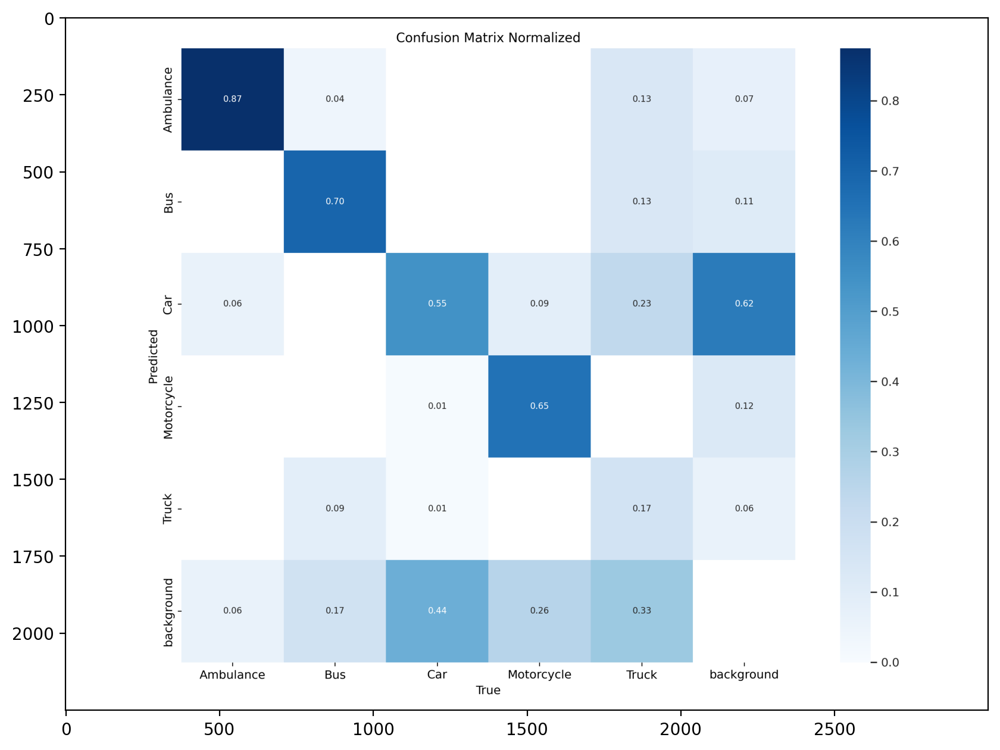

In [ ]:
# матрица ошибок
img_dir = os.path.join(data_dir_11n, 'confusion_matrix_normalized.png')
result_train(img_dir)

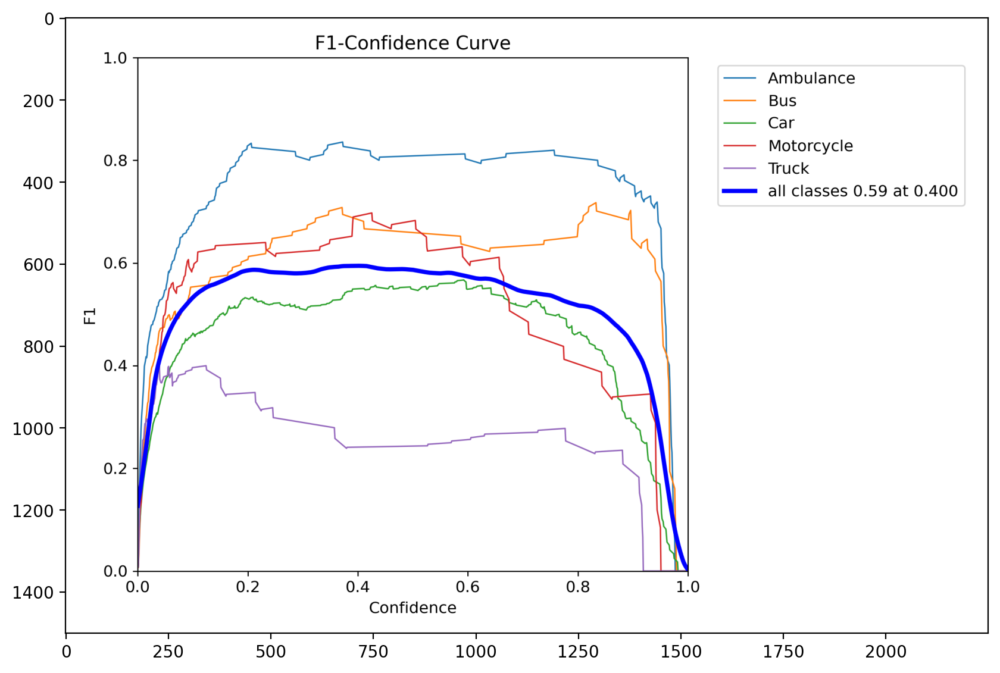

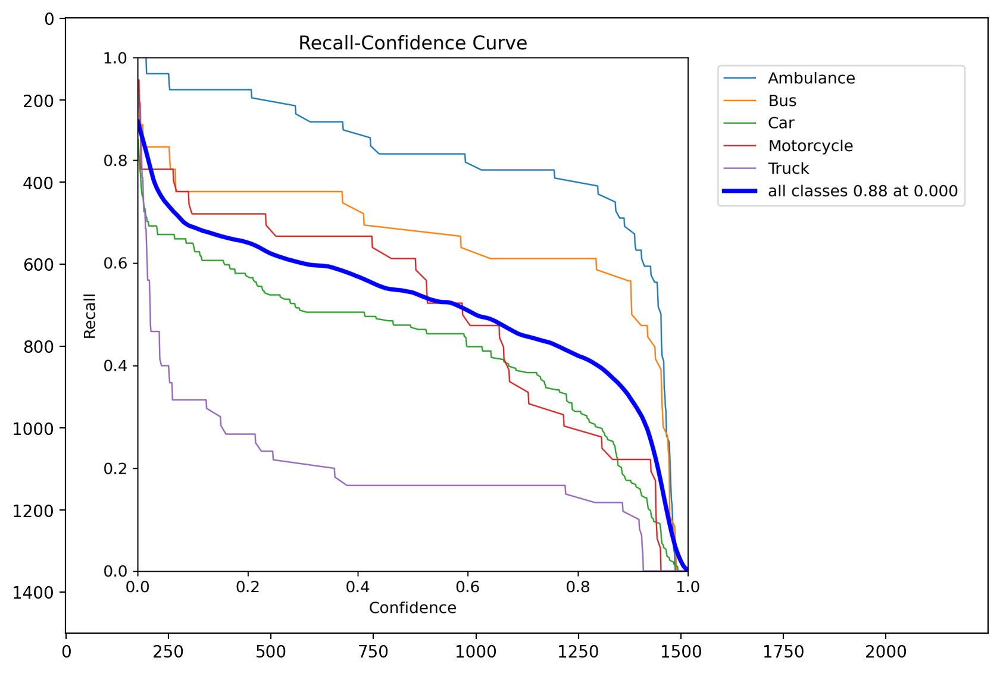

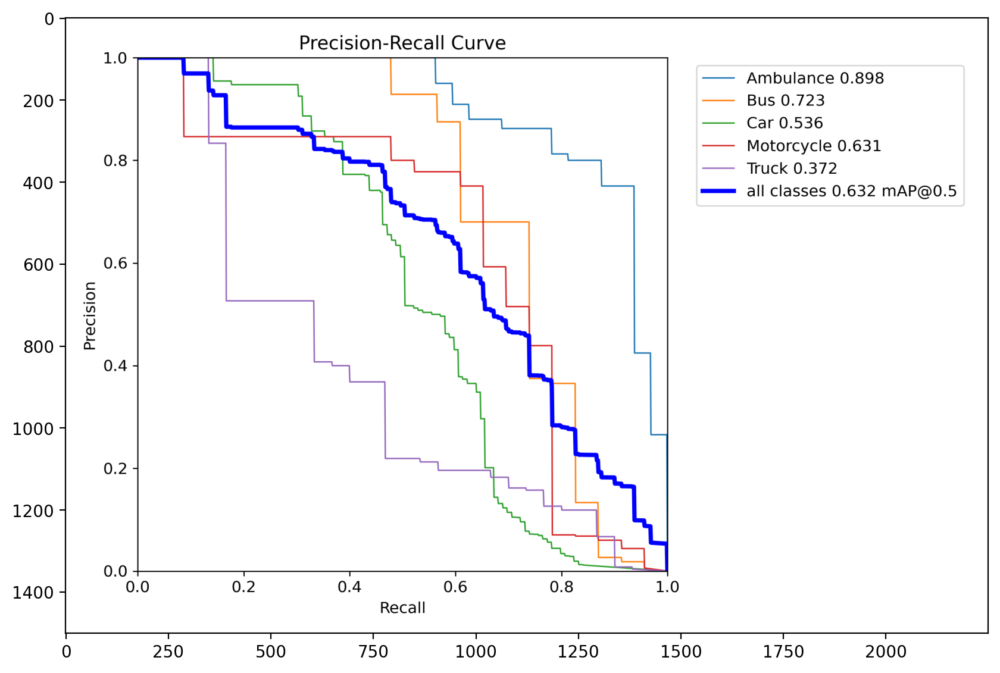

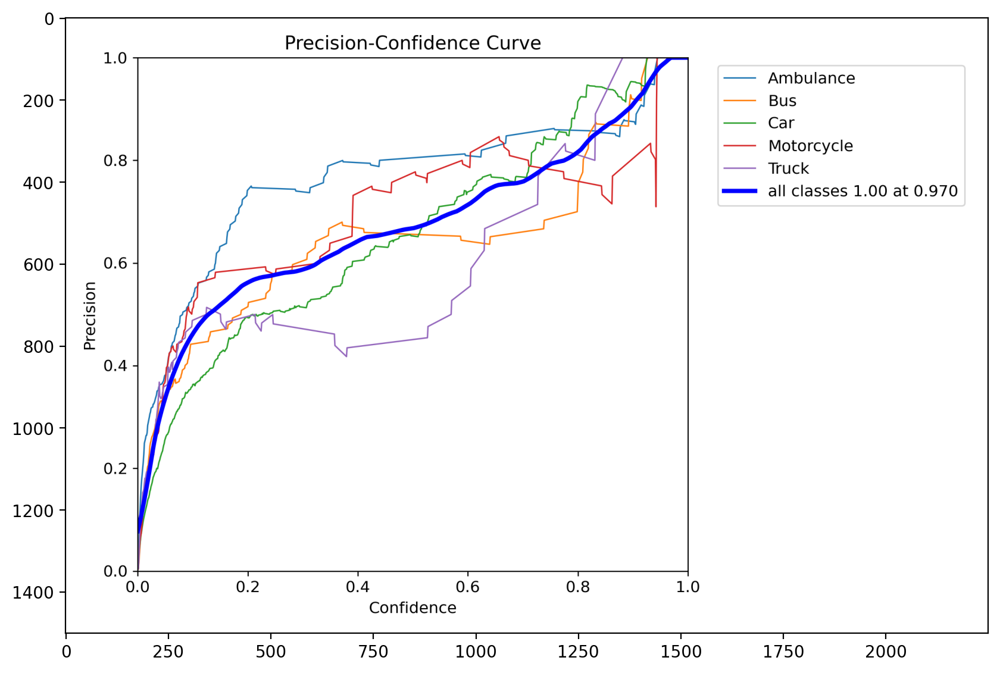

In [ ]:
# прочие метрики
metric_dir = os.path.join(data_dir_11n,'*curve*.png')
files_metric = glob.glob(metric_dir)
imgs_metric = []
for image in files_metric:
    result_train(image)

In [ ]:
# tensor board
%load_ext tensorboard
%tensorboard --logdir='./runs/detect/advanced_11n'

In [ ]:
# детекция с помощью Yolo11n
frame_times_11n, detection_counts_11n = video_detection(model_11n, cap=cap_11n)

Выходные данные были обрезаны до нескольких последних строк (5000).
0: 256x416 4 Cars, 1 Motorcycle, 9.9ms
Speed: 1.9ms preprocess, 9.9ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 416)

0: 256x416 5 Cars, 1 Motorcycle, 10.9ms
Speed: 1.6ms preprocess, 10.9ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 416)

0: 256x416 5 Cars, 1 Motorcycle, 12.0ms
Speed: 1.6ms preprocess, 12.0ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 416)

0: 256x416 6 Cars, 1 Motorcycle, 9.1ms
Speed: 1.7ms preprocess, 9.1ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 416)

0: 256x416 7 Cars, 1 Motorcycle, 14.3ms
Speed: 1.5ms preprocess, 14.3ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 416)

0: 256x416 9 Cars, 1 Motorcycle, 11.7ms
Speed: 1.5ms preprocess, 11.7ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 416)

0: 256x416 6 Cars, 1 Motorcycle, 13.5ms
Speed: 1.7ms preprocess, 13.5ms inference, 1.1ms postprocess per ima

In [ ]:
# Анализ результатов
average_frame_time_11n = sum(frame_times_11n) / len(frame_times_11n)
average_detections_11n = sum(detection_counts_11n) / len(detection_counts_11n)

print(f"Среднее время обработки кадра: {average_frame_time_11n:.4f} секунд")
print(f"Среднее количество обнаруженных объектов: {average_detections_11n:.2f}")

Среднее время обработки кадра: 0.0274 секунд
Среднее количество обнаруженных объектов: 2.79


## Демонстрация потоковой детекции YOLO 11n

In [ ]:
# запуск потоковой детекции
video_output_11n = model_11n.predict(source=video_path, conf=0.6, save=True)



WARNING ⚠️ inference results will accumulate in RAM unless `stream=True` is passed, causing potential out-of-memory
errors for large sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

video 1/1 (frame 1/2362) /content/TestVideo/TrafficPolice.mp4: 256x416 5 Cars, 12.0ms
video 1/1 (frame 2/2362) /content/TestVideo/TrafficPolice.mp4: 256x416 5 Cars, 18.2ms
video 1/1 (frame 3/2362) /content/TestVideo/TrafficPolice.mp4: 256x416 5 Cars, 12.8ms
video 1/1 (frame 4/2362) /content/TestVideo/TrafficPolice.mp4: 256x416 6 Cars, 11.7ms
video 1/1 (frame 5/2362) /content/TestVideo/TrafficPolice.mp4: 256x416 5 Cars, 11.5ms
video 1/1 (frame 6/2362) /

In [ ]:
# вывод изображения в colab
predicted_video = './runs/detect/advanced_11n2/TrafficPolice.avi'
clip = VideoFileClip(predicted_video)
clip.ipython_display(width=960, maxduration=100)

# YOLO11s


## Вариант 1 (загрузка уже дообученной модели)

In [ ]:
# создание копии для загрузки модели
source_load_11s = './drive/MyDrive/advanced_11s'
dest_load_11s = './runs/detect/advanced_11s'

transfer_model(source_load_11s, dest_load_11s)

In [ ]:
# загрузка уже предобученной модели
model_11s_path = os.path.join(dest_load_11s,'weights/best.pt')
model_11s = YOLO(model_11s_path)

## Вариант 2 (дообучение модели)

In [ ]:
# инициализация модели
model_11s = YOLO('yolo11s.pt')

In [ ]:
# обучение
results_11s = model_11s.train(
      data=yaml_path,     # расположение yaml файла
      epochs=30,          # количество эпох обучения
      batch=16,           # размер пакета
      imgsz=416,          # размер изображений
      plots=True,         # сохранение графиков
      name='advanced_11s' # имя дериктории сохранения
)

Ultralytics 8.3.78 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolo11s.pt, data=./VehiclesDetectionDataset/dataset.yaml, epochs=30, time=None, patience=100, batch=16, imgsz=416, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=advanced_11s2, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_

100%|██████████| 755k/755k [00:00<00:00, 109MB/s]


Overriding model.yaml nc=80 with nc=5

                   from  n    params  module                                       arguments                     
  0                  -1  1       928  ultralytics.nn.modules.conv.Conv             [3, 32, 3, 2]                 
  1                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  2                  -1  1     26080  ultralytics.nn.modules.block.C3k2            [64, 128, 1, False, 0.25]     
  3                  -1  1    147712  ultralytics.nn.modules.conv.Conv             [128, 128, 3, 2]              
  4                  -1  1    103360  ultralytics.nn.modules.block.C3k2            [128, 256, 1, False, 0.25]    
  5                  -1  1    590336  ultralytics.nn.modules.conv.Conv             [256, 256, 3, 2]              
  6                  -1  1    346112  ultralytics.nn.modules.block.C3k2            [256, 256, 1, True]           
  7                  -1  1   1180672  ultralytics

100%|██████████| 5.35M/5.35M [00:00<00:00, 272MB/s]


AMP: checks passed ✅


train: Scanning /content/VehiclesDetectionDataset/train/labels... 878 images, 0 backgrounds, 0 corrupt: 100%|██████████| 878/878 [00:00<00:00, 2072.72it/s]

train: New cache created: /content/VehiclesDetectionDataset/train/labels.cache


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


val: Scanning /content/VehiclesDetectionDataset/valid/labels... 250 images, 0 backgrounds, 0 corrupt: 100%|██████████| 250/250 [00:00<00:00, 1150.34it/s]

val: New cache created: /content/VehiclesDetectionDataset/valid/labels.cache


Plotting labels to runs/detect/advanced_11s2/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001111, momentum=0.9) with parameter groups 81 weight(decay=0.0), 88 weight(decay=0.0005), 87 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 416 train, 416 val
Using 2 dataloader workers
Logging results to runs/detect/advanced_11s2
Starting training for 30 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/30      1.93G      1.112      2.083      1.317         51        416: 100%|██████████| 55/55 [00:13<00:00,  4.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:03<00:00,  2.56it/s]

                   all        250        454      0.542      0.537      0.518      0.352



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/30      1.91G      1.232      1.798      1.367         59        416: 100%|██████████| 55/55 [00:11<00:00,  4.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.91it/s]


                   all        250        454      0.394      0.302      0.285      0.165

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/30      1.89G      1.303      1.866      1.424         54        416: 100%|██████████| 55/55 [00:11<00:00,  4.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.91it/s]


                   all        250        454      0.612      0.277      0.263      0.158

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/30      1.91G      1.329      1.866      1.432         61        416: 100%|██████████| 55/55 [00:12<00:00,  4.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  5.04it/s]


                   all        250        454      0.203      0.372      0.247      0.133

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/30      1.87G      1.308        1.8      1.403         40        416: 100%|██████████| 55/55 [00:11<00:00,  4.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.75it/s]


                   all        250        454      0.372      0.404      0.314      0.182

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/30      1.91G      1.293      1.748      1.399         48        416: 100%|██████████| 55/55 [00:10<00:00,  5.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  5.12it/s]


                   all        250        454      0.414      0.371      0.327      0.193

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/30       1.9G      1.235      1.686      1.383         47        416: 100%|██████████| 55/55 [00:10<00:00,  5.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.76it/s]

                   all        250        454      0.528      0.258      0.248      0.148



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/30      1.92G       1.21      1.611      1.362         64        416: 100%|██████████| 55/55 [00:10<00:00,  5.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.39it/s]

                   all        250        454      0.535      0.449      0.453      0.313



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/30      1.88G      1.185      1.529      1.331         28        416: 100%|██████████| 55/55 [00:10<00:00,  5.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.57it/s]

                   all        250        454      0.497      0.438      0.448      0.321



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/30      1.91G      1.153      1.503      1.319         44        416: 100%|██████████| 55/55 [00:10<00:00,  5.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.55it/s]


                   all        250        454      0.524      0.481      0.462       0.32

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/30      1.91G      1.121      1.426      1.296         69        416: 100%|██████████| 55/55 [00:10<00:00,  5.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.08it/s]


                   all        250        454      0.536      0.504      0.482      0.341

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/30      1.88G      1.076      1.341      1.259         71        416: 100%|██████████| 55/55 [00:11<00:00,  4.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.91it/s]

                   all        250        454      0.519      0.535      0.501      0.374



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/30      1.89G      1.046      1.295      1.253         53        416: 100%|██████████| 55/55 [00:11<00:00,  4.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.98it/s]


                   all        250        454      0.711      0.411      0.494      0.359

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/30      1.89G      1.047      1.232      1.247         60        416: 100%|██████████| 55/55 [00:11<00:00,  4.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  5.06it/s]

                   all        250        454      0.708       0.45      0.514      0.366



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/30      1.91G     0.9993      1.179      1.215         52        416: 100%|██████████| 55/55 [00:11<00:00,  4.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  5.00it/s]

                   all        250        454      0.664      0.477       0.56      0.411



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/30      1.91G     0.9857      1.178      1.213         37        416: 100%|██████████| 55/55 [00:11<00:00,  4.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  5.05it/s]

                   all        250        454      0.598      0.488      0.507      0.367



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/30      1.88G     0.9767      1.117      1.203         65        416: 100%|██████████| 55/55 [00:10<00:00,  5.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  5.11it/s]

                   all        250        454      0.561      0.515      0.535       0.38



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/30      1.91G     0.9639      1.098      1.195         59        416: 100%|██████████| 55/55 [00:11<00:00,  4.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  5.08it/s]

                   all        250        454      0.596        0.5      0.542       0.41



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/30      1.89G     0.9283      1.014      1.175         48        416: 100%|██████████| 55/55 [00:11<00:00,  4.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  5.17it/s]

                   all        250        454      0.609      0.488       0.54      0.414



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/30       1.9G     0.9276      1.013       1.19         47        416: 100%|██████████| 55/55 [00:10<00:00,  5.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  5.12it/s]

                   all        250        454      0.589      0.514      0.534      0.413


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/30      1.88G      0.851     0.8855       1.12         23        416: 100%|██████████| 55/55 [00:11<00:00,  4.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  5.04it/s]


                   all        250        454      0.604       0.52       0.55        0.4

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/30      1.91G      0.831     0.8252      1.123         21        416: 100%|██████████| 55/55 [00:10<00:00,  5.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  5.03it/s]

                   all        250        454      0.494      0.543       0.53      0.393



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/30      1.89G     0.7762     0.7413      1.079         18        416: 100%|██████████| 55/55 [00:10<00:00,  5.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  5.17it/s]

                   all        250        454      0.559       0.57      0.564       0.43



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/30      1.92G     0.7508     0.6989      1.076         20        416: 100%|██████████| 55/55 [00:10<00:00,  5.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  5.12it/s]


                   all        250        454      0.594       0.57      0.572      0.451

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/30      1.88G     0.7369     0.6355      1.056         26        416: 100%|██████████| 55/55 [00:10<00:00,  5.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  5.17it/s]

                   all        250        454      0.637      0.572      0.585      0.454



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/30      1.92G     0.7132     0.6054      1.044         30        416: 100%|██████████| 55/55 [00:10<00:00,  5.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  5.12it/s]

                   all        250        454      0.656      0.529      0.581      0.447



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/30       1.9G     0.6908     0.5773      1.039         31        416: 100%|██████████| 55/55 [00:10<00:00,  5.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  5.15it/s]

                   all        250        454      0.667      0.552      0.614      0.474



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/30      1.91G     0.6527     0.5418      1.024         27        416: 100%|██████████| 55/55 [00:10<00:00,  5.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  5.10it/s]

                   all        250        454      0.731      0.541      0.618      0.478



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/30       1.9G     0.6526     0.5178      1.018         37        416: 100%|██████████| 55/55 [00:10<00:00,  5.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  5.19it/s]

                   all        250        454      0.632      0.613      0.612      0.478



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/30      1.89G     0.6237     0.4854          1         25        416: 100%|██████████| 55/55 [00:10<00:00,  5.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  5.17it/s]

                   all        250        454      0.697      0.564      0.607      0.475



30 epochs completed in 0.116 hours.
Optimizer stripped from runs/detect/advanced_11s2/weights/last.pt, 19.1MB
Optimizer stripped from runs/detect/advanced_11s2/weights/best.pt, 19.1MB

Validating runs/detect/advanced_11s2/weights/best.pt...
Ultralytics 8.3.78 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11s summary (fused): 100 layers, 9,414,735 parameters, 0 gradients, 21.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.75it/s]


                   all        250        454      0.731      0.541      0.618      0.478
             Ambulance         50         64       0.89      0.759      0.921      0.816
                   Bus         30         46      0.788      0.696      0.726      0.629
                   Car         90        238      0.665       0.42      0.498      0.334
            Motorcycle         42         46      0.695      0.495      0.531      0.305
                 Truck         38         60       0.62      0.333      0.416      0.308
Speed: 0.4ms preprocess, 2.4ms inference, 0.0ms loss, 1.9ms postprocess per image
Results saved to runs/detect/advanced_11s2


In [ ]:
# # сохранение дообученной модели
# source_save_11s = './runs/detect/advanced_11s2'
# dest_save_11s = './drive/MyDrive/advanced_11s'

# transfer_model(source_save_11s, dest_save_11s)

## Результаты обучения

In [ ]:
data_dir_11s = dest_load_11s
detect_sample(data_dir_11s)

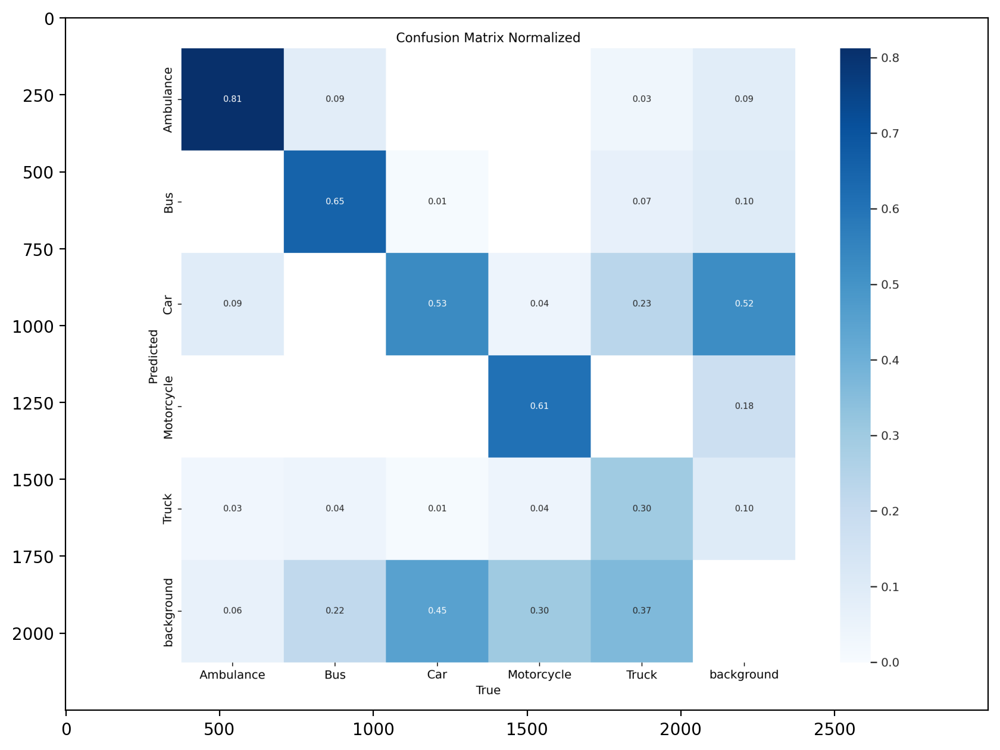

In [ ]:
# матрица ошибок
img_dir = os.path.join(data_dir_11s, 'confusion_matrix_normalized.png')
result_train(img_dir)

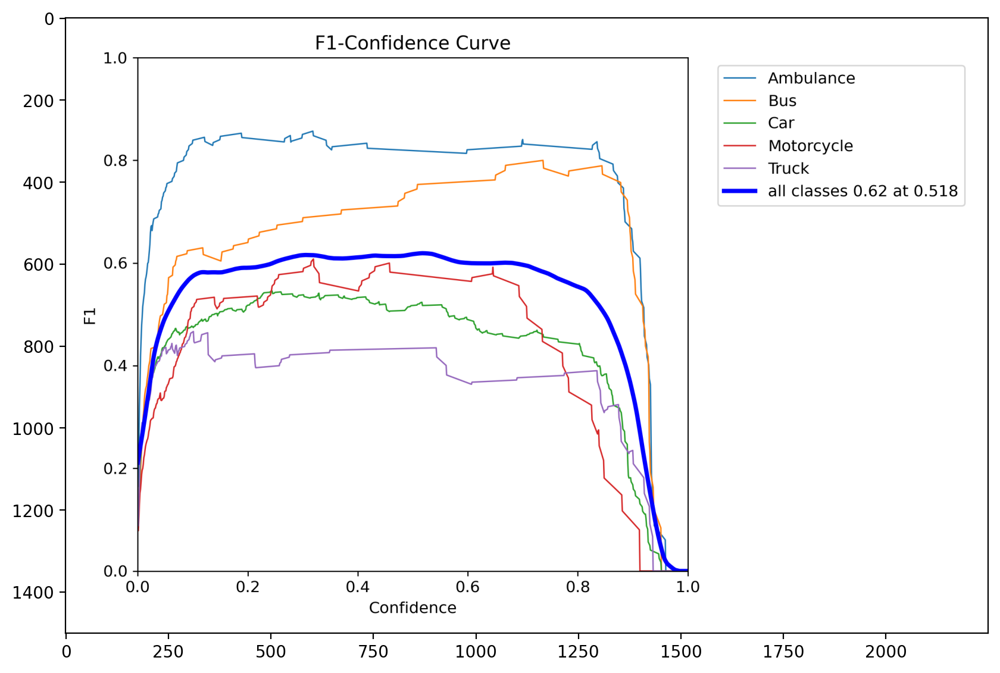

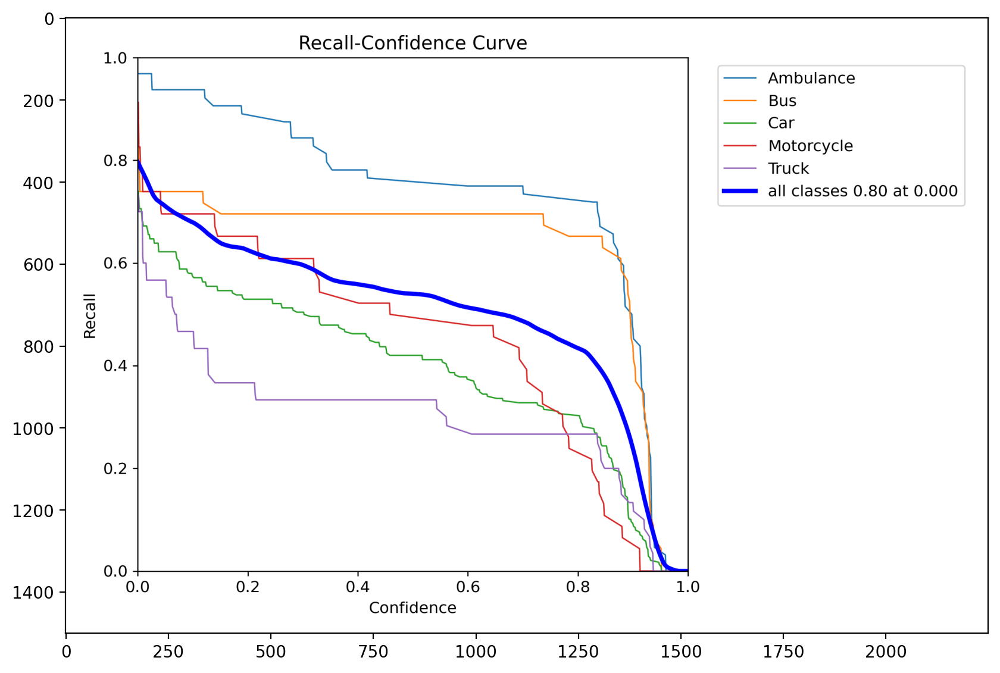

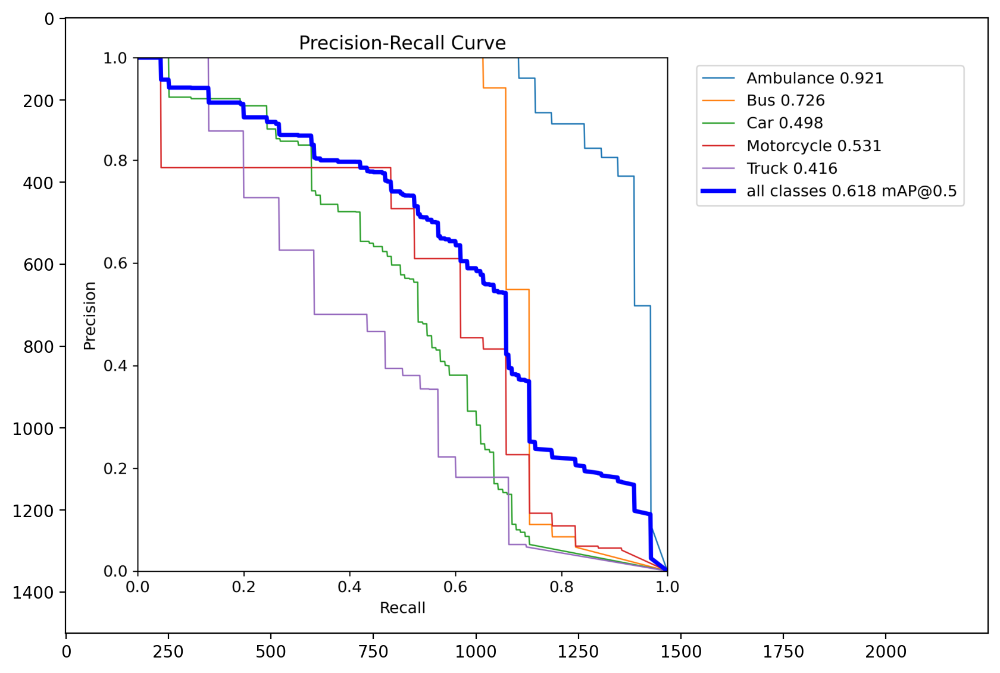

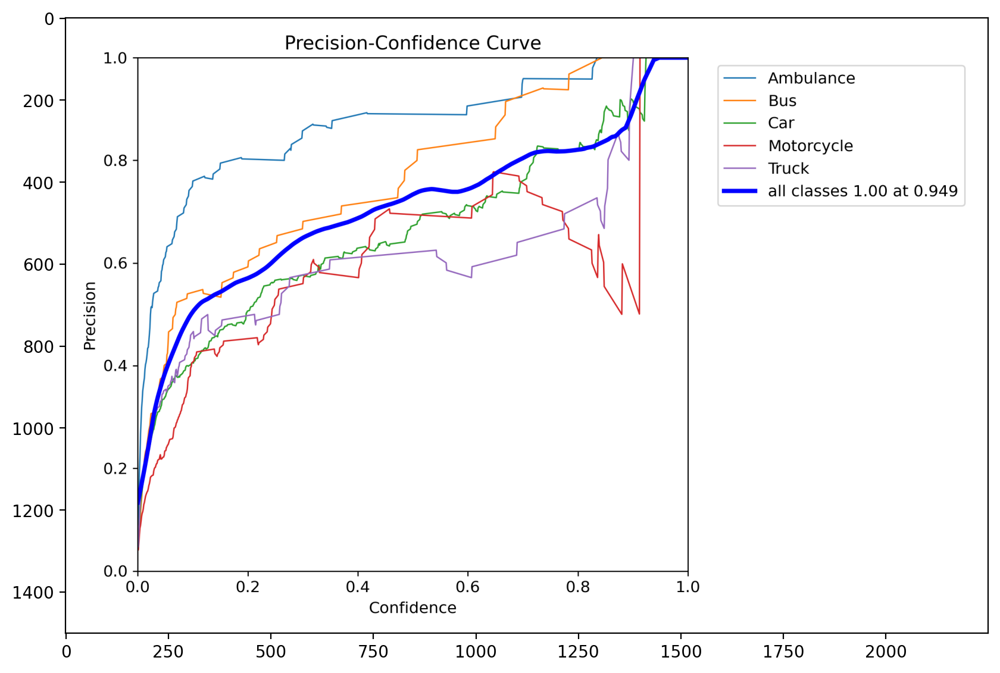

In [ ]:
# прочие метрики
metric_dir = os.path.join(data_dir_11s,'*curve*.png')
files_metric = glob.glob(metric_dir)
imgs_metric = []
for image in files_metric:
    result_train(image)

In [ ]:
# tensor board
%load_ext tensorboard
%tensorboard --logdir='./runs/detect/advanced_11s'

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


<IPython.core.display.Javascript object>

In [ ]:
#  детекция по видео
frame_times_11s, detection_counts_11s = video_detection(model_11s, cap=cap_11s)

Выходные данные были обрезаны до нескольких последних строк (5000).
0: 256x416 6 Cars, 16.8ms
Speed: 1.6ms preprocess, 16.8ms inference, 1.9ms postprocess per image at shape (1, 3, 256, 416)

0: 256x416 6 Cars, 17.0ms
Speed: 1.8ms preprocess, 17.0ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 416)

0: 256x416 7 Cars, 14.9ms
Speed: 2.3ms preprocess, 14.9ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 416)

0: 256x416 6 Cars, 12.6ms
Speed: 3.2ms preprocess, 12.6ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 416)

0: 256x416 5 Cars, 14.2ms
Speed: 1.5ms preprocess, 14.2ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 416)

0: 256x416 7 Cars, 17.4ms
Speed: 2.5ms preprocess, 17.4ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 416)

0: 256x416 9 Cars, 12.2ms
Speed: 3.1ms preprocess, 12.2ms inference, 1.1ms postprocess per image at shape (1, 3, 256, 416)

0: 256x416 6 Cars, 10.8ms
Speed: 1.6ms preprocess, 10.8ms infere

In [ ]:
# Анализ результатов
average_frame_time_11s = sum(frame_times_11s) / len(frame_times_11s)
average_detections_11s = sum(detection_counts_11s) / len(detection_counts_11s)

print(f"Среднее время обработки кадра: {average_frame_time_11s:.4f} секунд")
print(f"Среднее количество обнаруженных объектов: {average_detections_11s:.2f}")

Среднее время обработки кадра: 0.0263 секунд
Среднее количество обнаруженных объектов: 3.18


## Демонстрация потоковой детекции YOLO 11s

In [ ]:
# запуск потоковой детекции
video_output_11s = model_11s.predict(source=video_path, conf=0.6, save=True)



WARNING ⚠️ inference results will accumulate in RAM unless `stream=True` is passed, causing potential out-of-memory
errors for large sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

video 1/1 (frame 1/2362) /content/TestVideo/TrafficPolice.mp4: 256x416 5 Cars, 24.8ms
video 1/1 (frame 2/2362) /content/TestVideo/TrafficPolice.mp4: 256x416 5 Cars, 25.7ms
video 1/1 (frame 3/2362) /content/TestVideo/TrafficPolice.mp4: 256x416 6 Cars, 16.7ms
video 1/1 (frame 4/2362) /content/TestVideo/TrafficPolice.mp4: 256x416 5 Cars, 13.0ms
video 1/1 (frame 5/2362) /content/TestVideo/TrafficPolice.mp4: 256x416 6 Cars, 13.8ms
video 1/1 (frame 6/2362) /

In [ ]:
# вывод изображения в colab
predicted_video_11s = './runs/detect/advanced_11s22/TrafficPolice.avi'
clip_2 = VideoFileClip(predicted_video_11s)
clip_2.ipython_display(width=960, maxduration=100)

# YOLO 11L

## Вариант 1 (загрузка уже дообученой модели)

In [ ]:
# создание копии для загрузки модели
source_load_11l = './drive/MyDrive/advanced_11l'
dest_load_11l = './runs/detect/advanced_11l'

transfer_model(source_load_11l, dest_load_11l)

In [ ]:
# загрузка уже предобученной модели
model_11l_path = os.path.join(dest_load_11l,'weights/best.pt')
model_11l = YOLO(model_11l_path)

## Вариант 2 (дообучение модели)

In [ ]:
# инициализация модели
model_11l = YOLO('yolo11l.pt')

100%|██████████| 49.0M/49.0M [00:00<00:00, 262MB/s]


In [ ]:
# обучение
results_11l = model_11l.train(
      data=yaml_path,     # расположение yaml файла
      epochs=30,          # количество эпох обучения
      batch=16,           # размер пакета
      imgsz=416,          # размер изображений
      plots=True,         # сохранение графиков
      name='advanced_11l' # имя дериктории сохранения
)

Ultralytics 8.3.78 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolo11l.pt, data=./VehiclesDetectionDataset/dataset.yaml, epochs=30, time=None, patience=100, batch=16, imgsz=416, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=advanced_11l, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_c

100%|██████████| 755k/755k [00:00<00:00, 14.4MB/s]


Overriding model.yaml nc=80 with nc=5

                   from  n    params  module                                       arguments                     
  0                  -1  1      1856  ultralytics.nn.modules.conv.Conv             [3, 64, 3, 2]                 
  1                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  2                  -1  2    173824  ultralytics.nn.modules.block.C3k2            [128, 256, 2, True, 0.25]     
  3                  -1  1    590336  ultralytics.nn.modules.conv.Conv             [256, 256, 3, 2]              
  4                  -1  2    691712  ultralytics.nn.modules.block.C3k2            [256, 512, 2, True, 0.25]     
  5                  -1  1   2360320  ultralytics.nn.modules.conv.Conv             [512, 512, 3, 2]              
  6                  -1  2   2234368  ultralytics.nn.modules.block.C3k2            [512, 512, 2, True]           
  7                  -1  1   2360320  ultralytics

100%|██████████| 5.35M/5.35M [00:00<00:00, 66.3MB/s]


AMP: checks passed ✅


train: Scanning /content/VehiclesDetectionDataset/train/labels... 878 images, 0 backgrounds, 0 corrupt: 100%|██████████| 878/878 [00:00<00:00, 2140.73it/s]

train: New cache created: /content/VehiclesDetectionDataset/train/labels.cache


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


val: Scanning /content/VehiclesDetectionDataset/valid/labels... 250 images, 0 backgrounds, 0 corrupt: 100%|██████████| 250/250 [00:00<00:00, 987.26it/s] 

val: New cache created: /content/VehiclesDetectionDataset/valid/labels.cache


Plotting labels to runs/detect/advanced_11l/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001111, momentum=0.9) with parameter groups 167 weight(decay=0.0), 174 weight(decay=0.0005), 173 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 416 train, 416 val
Using 2 dataloader workers
Logging results to runs/detect/advanced_11l
Starting training for 30 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/30      4.96G      1.168      2.183      1.435         51        416: 100%|██████████| 55/55 [00:25<00:00,  2.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.62it/s]

                   all        250        454       0.25      0.315       0.25       0.13



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/30      4.91G       1.48      2.183      1.683         59        416: 100%|██████████| 55/55 [00:24<00:00,  2.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.05it/s]

                   all        250        454      0.122      0.165     0.0598     0.0237



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/30      4.91G       1.56      2.351      1.752         54        416: 100%|██████████| 55/55 [00:20<00:00,  2.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.30it/s]

                   all        250        454      0.237     0.0674     0.0145    0.00598



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/30       4.9G      1.517      2.317      1.731         61        416: 100%|██████████| 55/55 [00:20<00:00,  2.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.95it/s]

                   all        250        454      0.154      0.189     0.0706      0.032



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/30      4.87G       1.52      2.244       1.69         40        416: 100%|██████████| 55/55 [00:20<00:00,  2.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.32it/s]

                   all        250        454       0.07      0.243     0.0655     0.0323



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/30      4.91G      1.475      2.163      1.666         48        416: 100%|██████████| 55/55 [00:22<00:00,  2.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.99it/s]

                   all        250        454      0.212      0.232       0.16     0.0817



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/30       4.9G      1.429       2.09      1.671         47        416: 100%|██████████| 55/55 [00:20<00:00,  2.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.05it/s]

                   all        250        454      0.326      0.347      0.292      0.162



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/30       4.9G      1.353      1.946      1.594         64        416: 100%|██████████| 55/55 [00:20<00:00,  2.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.07it/s]

                   all        250        454      0.271      0.417      0.268      0.159



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/30      4.86G      1.355      1.893      1.581         28        416: 100%|██████████| 55/55 [00:20<00:00,  2.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.02it/s]

                   all        250        454      0.534      0.315      0.336      0.195



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/30       4.9G      1.285      1.849      1.523         44        416: 100%|██████████| 55/55 [00:20<00:00,  2.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.03it/s]

                   all        250        454      0.292      0.383      0.295      0.172



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/30       4.9G       1.26       1.82       1.51         69        416: 100%|██████████| 55/55 [00:20<00:00,  2.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.26it/s]

                   all        250        454      0.641      0.279      0.324       0.22



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/30      4.91G       1.21        1.7       1.48         71        416: 100%|██████████| 55/55 [00:20<00:00,  2.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.34it/s]

                   all        250        454      0.366      0.469      0.404      0.275



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/30      4.85G      1.166      1.657      1.459         53        416: 100%|██████████| 55/55 [00:20<00:00,  2.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.37it/s]

                   all        250        454      0.463      0.494       0.48      0.336



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/30       4.9G      1.178      1.608      1.474         60        416: 100%|██████████| 55/55 [00:20<00:00,  2.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.33it/s]

                   all        250        454      0.641      0.403       0.45      0.301



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/30       4.9G      1.134      1.515      1.431         52        416: 100%|██████████| 55/55 [00:20<00:00,  2.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.36it/s]

                   all        250        454      0.669      0.345      0.415      0.314



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/30      4.91G      1.096        1.5      1.413         37        416: 100%|██████████| 55/55 [00:20<00:00,  2.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.37it/s]

                   all        250        454        0.5      0.494       0.49       0.36



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/30      4.86G       1.09      1.422      1.405         65        416: 100%|██████████| 55/55 [00:20<00:00,  2.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.84it/s]

                   all        250        454      0.397      0.511      0.442      0.335



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/30       4.9G      1.091      1.408      1.418         59        416: 100%|██████████| 55/55 [00:20<00:00,  2.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.80it/s]

                   all        250        454      0.525      0.536      0.537       0.39



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/30      4.89G      1.049      1.342      1.384         48        416: 100%|██████████| 55/55 [00:20<00:00,  2.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.02it/s]

                   all        250        454      0.544      0.506      0.508      0.378



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/30      4.91G      1.038      1.316      1.367         47        416: 100%|██████████| 55/55 [00:20<00:00,  2.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.92it/s]

                   all        250        454      0.551      0.488      0.498       0.38


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/30      4.86G     0.9678      1.209      1.309         23        416: 100%|██████████| 55/55 [00:21<00:00,  2.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.02it/s]

                   all        250        454      0.504      0.541      0.521      0.392



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/30       4.9G     0.9418      1.146      1.302         21        416: 100%|██████████| 55/55 [00:20<00:00,  2.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.89it/s]

                   all        250        454      0.535      0.532       0.53      0.389



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/30       4.9G     0.8964      1.093      1.269         18        416: 100%|██████████| 55/55 [00:20<00:00,  2.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.75it/s]

                   all        250        454      0.592      0.471      0.517      0.372



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/30      4.91G     0.8622     0.9782      1.256         20        416: 100%|██████████| 55/55 [00:20<00:00,  2.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.88it/s]

                   all        250        454      0.638      0.543      0.578      0.439



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/30      4.86G     0.8325     0.9115      1.228         26        416: 100%|██████████| 55/55 [00:20<00:00,  2.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.98it/s]

                   all        250        454      0.602      0.505      0.567      0.439



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/30      4.91G     0.8092     0.9034      1.197         30        416: 100%|██████████| 55/55 [00:20<00:00,  2.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.13it/s]

                   all        250        454       0.63      0.508      0.556      0.427



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/30       4.9G     0.7905     0.8044      1.197         31        416: 100%|██████████| 55/55 [00:20<00:00,  2.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.18it/s]

                   all        250        454       0.61      0.596      0.605      0.476



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/30      4.91G     0.7482     0.7641      1.167         27        416: 100%|██████████| 55/55 [00:20<00:00,  2.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.27it/s]

                   all        250        454      0.583      0.569      0.556      0.437



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/30      4.86G     0.7325     0.7441      1.164         37        416: 100%|██████████| 55/55 [00:20<00:00,  2.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.36it/s]

                   all        250        454      0.603      0.572      0.595      0.455



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/30       4.9G     0.6956     0.6736      1.129         25        416: 100%|██████████| 55/55 [00:20<00:00,  2.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.31it/s]

                   all        250        454      0.665      0.559      0.613       0.47



30 epochs completed in 0.221 hours.
Optimizer stripped from runs/detect/advanced_11l/weights/last.pt, 51.2MB
Optimizer stripped from runs/detect/advanced_11l/weights/best.pt, 51.2MB

Validating runs/detect/advanced_11l/weights/best.pt...
Ultralytics 8.3.78 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11l summary (fused): 190 layers, 25,283,167 parameters, 0 gradients, 86.6 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:03<00:00,  2.35it/s]


                   all        250        454       0.61      0.596      0.604      0.476
             Ambulance         50         64      0.751       0.85      0.878      0.778
                   Bus         30         46      0.628      0.696      0.725      0.622
                   Car         90        238      0.621      0.513      0.529      0.378
            Motorcycle         42         46       0.62      0.522      0.519      0.353
                 Truck         38         60      0.427        0.4      0.371      0.248
Speed: 0.1ms preprocess, 6.2ms inference, 0.0ms loss, 1.5ms postprocess per image
Results saved to runs/detect/advanced_11l


In [ ]:
# # сохранение дообученной модели
# source_save_11l = './runs/detect/advanced_11l' # внимательно следим за последней цифрой папки
# dest_save_11l = './drive/MyDrive/advanced_11l'

# transfer_model(source_save_11l, dest_save_11l)

## Результаты обучения

In [ ]:
data_dir_11l = dest_load_11l
detect_sample(data_dir_11l)

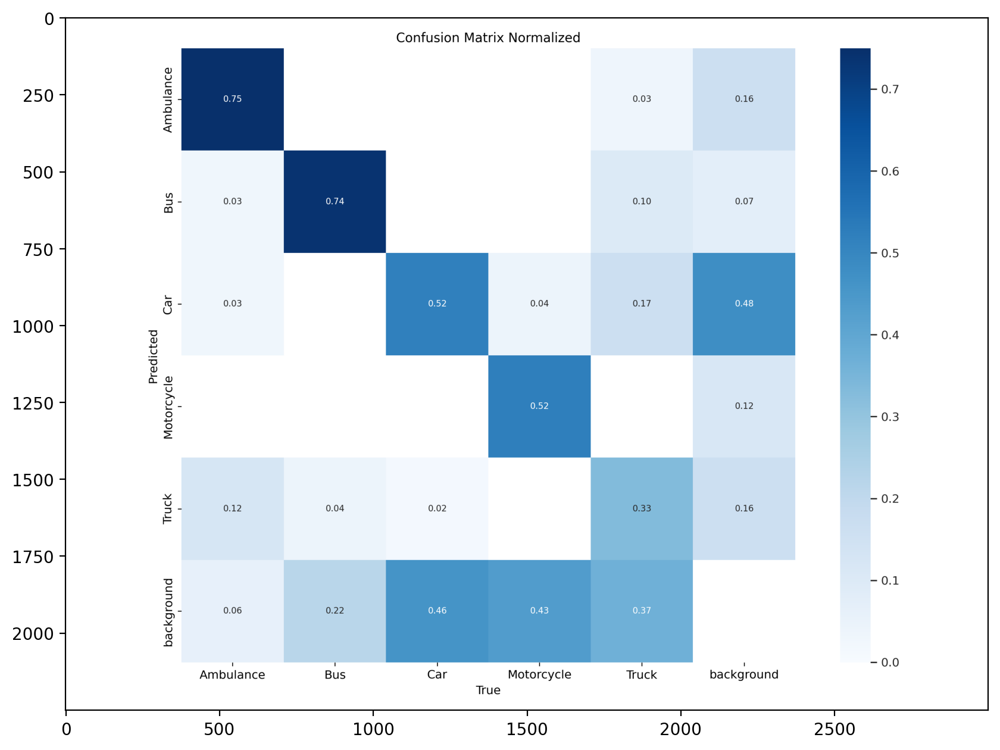

In [ ]:
# матрица ошибок
img_dir = os.path.join(data_dir_11l, 'confusion_matrix_normalized.png')
result_train(img_dir)

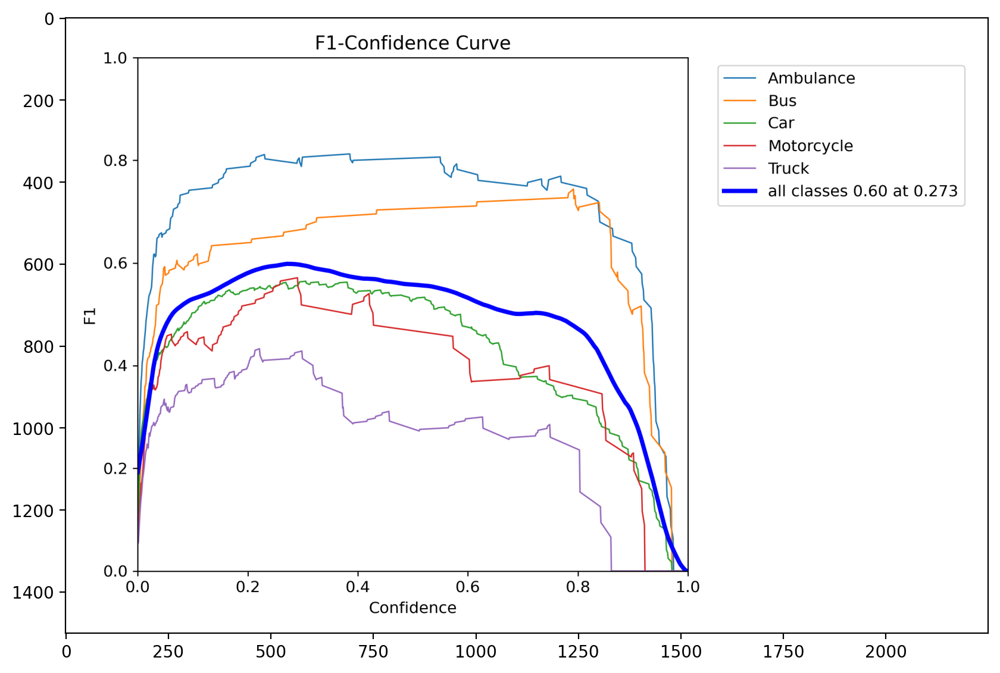

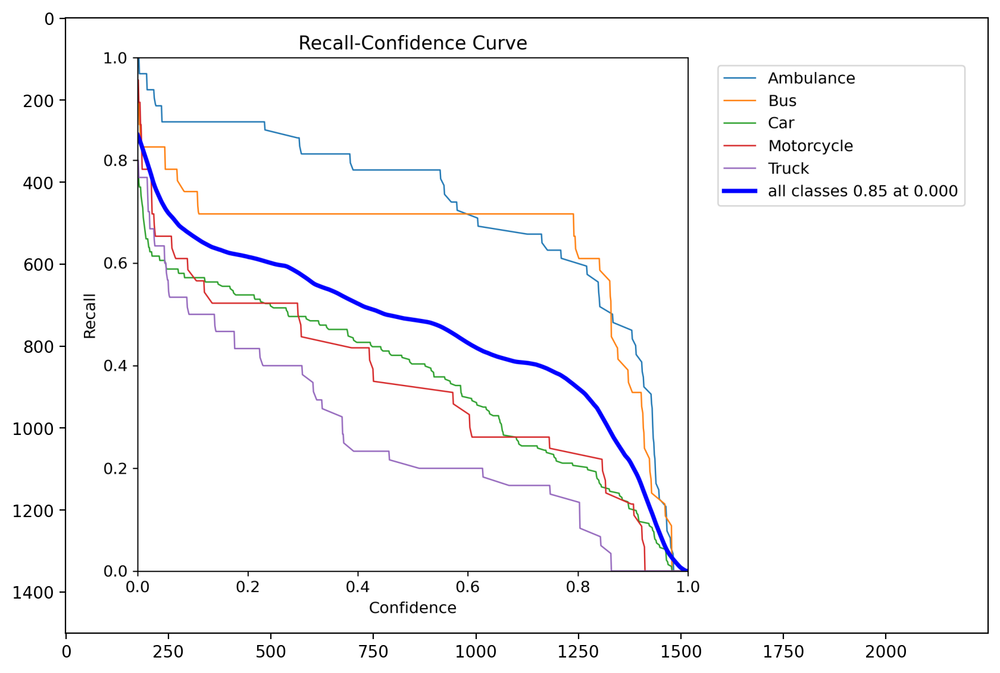

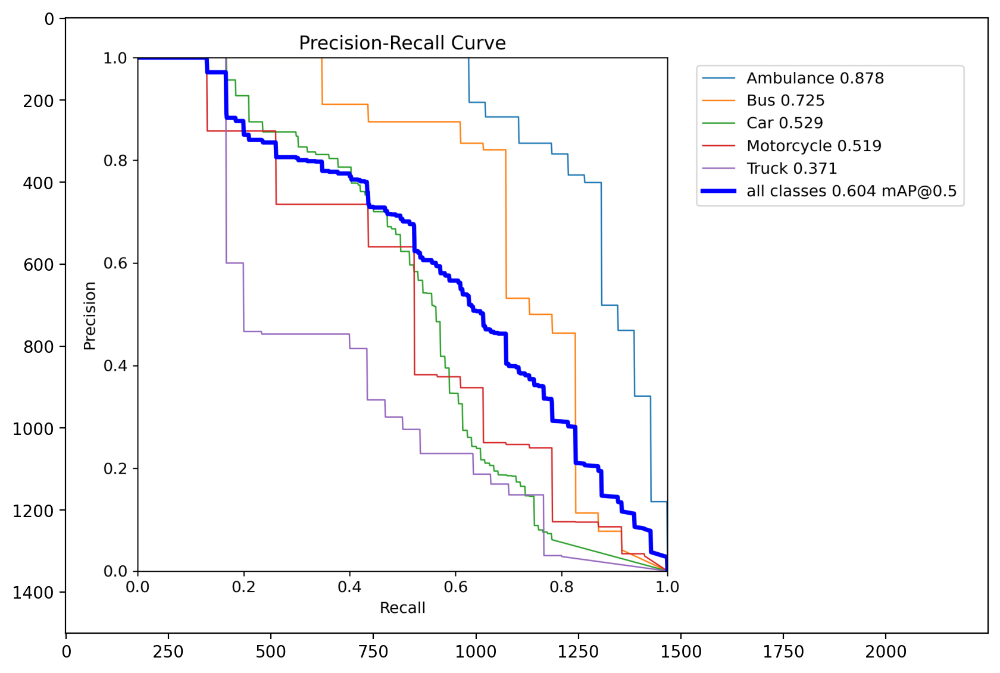

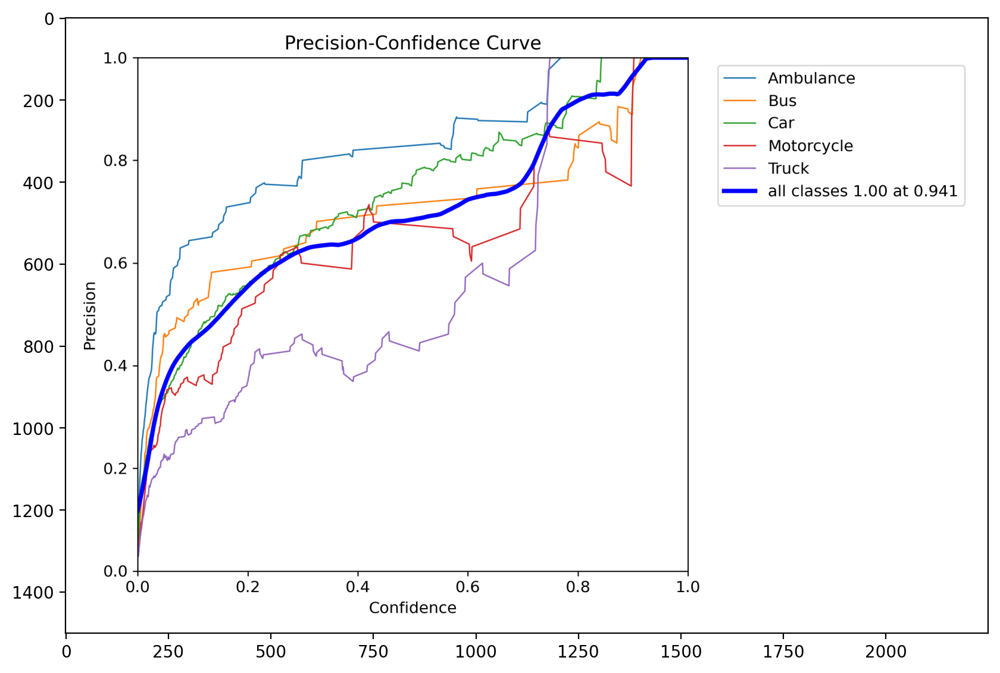

In [ ]:
# прочие метрики
metric_dir = os.path.join(data_dir_11l,'*curve*.png')
files_metric = glob.glob(metric_dir)
imgs_metric = []
for image in files_metric:
    result_train(image)

In [ ]:
# tensor board
%load_ext tensorboard
%tensorboard --logdir='./runs/detect/advanced_11l'

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


<IPython.core.display.Javascript object>

In [ ]:
# детекция с помощью Yolo11l
frame_times_11l, detection_counts_11l = video_detection(model_11l, cap=cap_11l)

Выходные данные были обрезаны до нескольких последних строк (5000).
0: 256x416 3 Cars, 19.7ms
Speed: 1.6ms preprocess, 19.7ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 416)

0: 256x416 3 Cars, 18.1ms
Speed: 1.6ms preprocess, 18.1ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 416)

0: 256x416 4 Cars, 23.1ms
Speed: 1.6ms preprocess, 23.1ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 416)

0: 256x416 3 Cars, 24.3ms
Speed: 1.9ms preprocess, 24.3ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 416)

0: 256x416 3 Cars, 22.3ms
Speed: 1.6ms preprocess, 22.3ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 416)

0: 256x416 4 Cars, 21.9ms
Speed: 1.6ms preprocess, 21.9ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 416)

0: 256x416 4 Cars, 20.8ms
Speed: 1.6ms preprocess, 20.8ms inference, 1.2ms postprocess per image at shape (1, 3, 256, 416)

0: 256x416 4 Cars, 21.9ms
Speed: 1.6ms preprocess, 21.9ms infere

In [ ]:
# Анализ результатов
average_frame_time_11l = sum(frame_times_11l) / len(frame_times_11l)
average_detections_11l = sum(detection_counts_11l) / len(detection_counts_11l)

print(f"Среднее время обработки кадра: {average_frame_time_11l:.4f} секунд")
print(f"Среднее количество обнаруженных объектов: {average_detections_11l:.2f}")

Среднее время обработки кадра: 0.0361 секунд
Среднее количество обнаруженных объектов: 2.44


## Демонстрация потоковой детекции YOLO 11l

In [ ]:
# запуск потоковой детекции
video_output_11l = model_11l.predict(source=video_path, conf=0.6, save=True)



WARNING ⚠️ inference results will accumulate in RAM unless `stream=True` is passed, causing potential out-of-memory
errors for large sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

video 1/1 (frame 1/2362) /content/TestVideo/TrafficPolice.mp4: 256x416 2 Cars, 67.3ms
video 1/1 (frame 2/2362) /content/TestVideo/TrafficPolice.mp4: 256x416 3 Cars, 33.7ms
video 1/1 (frame 3/2362) /content/TestVideo/TrafficPolice.mp4: 256x416 3 Cars, 36.2ms
video 1/1 (frame 4/2362) /content/TestVideo/TrafficPolice.mp4: 256x416 4 Cars, 32.7ms
video 1/1 (frame 5/2362) /content/TestVideo/TrafficPolice.mp4: 256x416 4 Cars, 30.6ms
video 1/1 (frame 6/2362) /

In [ ]:
# вывод изображения в colab
predicted_video_11l = './runs/detect/advanced_11l2/TrafficPolice.avi'
clip_3 = VideoFileClip(predicted_video_11l)
clip_3.ipython_display(width=960, maxduration=100)

# Сравнение результатов

In [ ]:
print(f'Среднее время обработки кадра: YOLO 11n {average_frame_time_11n:.4f} секунд \\ YOLO 11s {average_frame_time_11s:.4f} секунд \\ YOLO 11L {average_frame_time_11l:.4f} секунд')
print(f'Среднее количество обнаруженных объектов: YOLO 11n {average_detections_11n:.2f} \\ YOLO 11s {average_detections_11s:.2f}  \\  YOLO 11l {average_detections_11l:.2f}')

Среднее время обработки кадра: YOLO 11n 0.0274 секунд \ YOLO 11s 0.0263 секунд \ YOLO 11L 0.0361 секунд
Среднее количество обнаруженных объектов: YOLO 11n 2.79 \ YOLO 11s 3.18  \  YOLO 11l 2.44


**Графики обучения:**
Судя по графику metrics/mAP50 и metrics/mAP50-95 можно сказать, что:
1.	Все модели обучаются и улучшают свои показания.
2.	На ранних этапах происходит резкое падение графика mAP50, что является предсказуемым, т.к. модели обучаются.
3.	На всем протяжении обучения наблюдается устойчивый рост показателей моделей.
4.	В конце обучения модели начинают выходить на «плато», но можно добавить еще 10-20 эпох обучения для улучшения показателей.


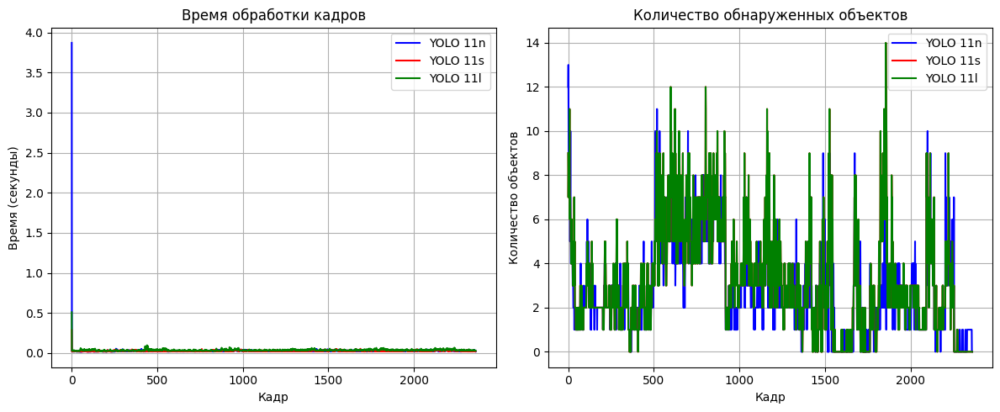

In [ ]:
# Графики
plt.figure(figsize=(12, 5))

plt.subplot(1, 2, 1)
plt.plot(frame_times_11n, label='YOLO 11n', color='blue')  # Первый набор данных синим цветом
plt.plot(frame_times_11s, label='YOLO 11s', color='red')   # Второй набор данных красным цветом
plt.plot(frame_times_11l, label='YOLO 11l', color='green')   # Третий набор данных зеленым цветом
plt.title("Время обработки кадров")
plt.xlabel("Кадр")
plt.ylabel("Время (секунды)")
plt.legend()  # Добавляем легенду
plt.grid(True) # добавляем сетку

plt.subplot(1, 2, 2)
plt.plot(detection_counts_11n, label='YOLO 11n', color='blue')
plt.plot(detection_counts_11s, label='YOLO 11s', color='red')
plt.plot(detection_counts_11s, label='YOLO 11l', color='green')
plt.title("Количество обнаруженных объектов")
plt.xlabel("Кадр")
plt.ylabel("Количество объектов")
plt.legend()
plt.grid(True)

plt.tight_layout()
plt.show()

**Время обработки кадра:**
Все три модели показывают относительно стабильное время обработки кадров на протяжении всего видео. Время обработки кадров для всех трех моделей в основном находится в очень низком диапазоне (около 0.05 секунд или меньше). На графике виды «выбросы» для YOLO 11n в начале видео, возможно это обусловлено сложностью сцены в конкретном кадре.

**Количество обнаруженных объектов:**
YOLO 11s (красный) и YOLO 11l (зеленый) показывают схожие результаты по количеству обнаруженных объектов, в то время как YOLO 11n (синий) показывает заметно меньшее количество обнаруженных объектов по сравнению с двумя другими моделями. Видно, что YOLO 11s и YOLO 11l обнаруживают больше объектов в кадрах, где их действительно больше.


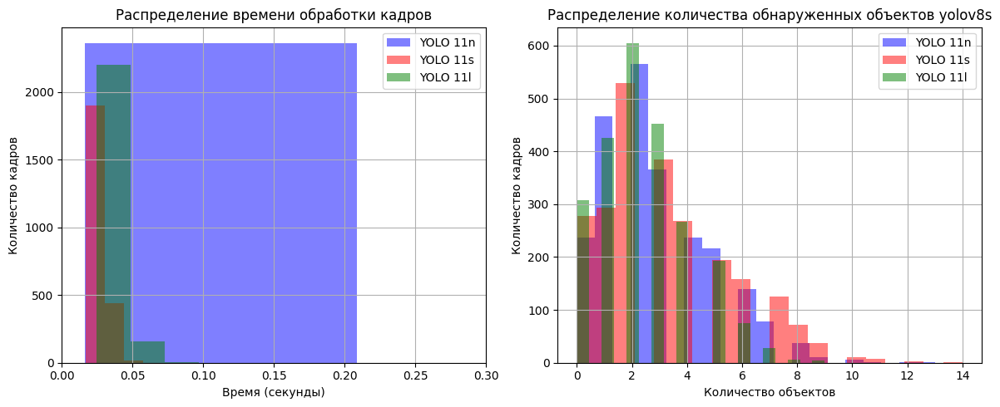

In [ ]:
plt.figure(figsize=(12, 5))

plt.subplot(1, 2, 1)
plt.hist(frame_times_11n, bins=20, alpha=0.5, label='YOLO 11n', color='blue')   # Первый набор данных синим цветом
plt.hist(frame_times_11s, bins=20, alpha=0.5, label='YOLO 11s', color='red')    # Второй набор данных красным цветом
plt.hist(frame_times_11l, bins=20, alpha=0.5, label='YOLO 11l', color='green')    # третий набор данных зеленым цветом

plt.title('Распределение времени обработки кадров')
plt.xlabel("Время (секунды)")
plt.ylabel("Количество кадров")
plt.legend(loc='upper right') # добавляем легенду
plt.grid(True) # добавляем сетку
plt.xlim(0, 0.3)

plt.subplot(1, 2, 2)
plt.hist(detection_counts_11n, bins=20, alpha=0.5, label='YOLO 11n', color='blue')
plt.hist(detection_counts_11s, bins=20, alpha=0.5, label='YOLO 11s', color='red')
plt.hist(detection_counts_11l, bins=20, alpha=0.5, label='YOLO 11l', color='green')

plt.title("Распределение количества обнаруженных объектов")
plt.xlabel("Количество объектов")
plt.ylabel("Количество кадров")
plt.legend(loc='upper right')
plt.grid(True)

plt.tight_layout()
plt.show()

**Время обработки кадра:**
YOLO 11s (красный) показывает самое быстрое время обработки кадров, так как большая часть кадров была обработана за очень короткое время. YOLO 11l (зеленый) также показывает быстрое время обработки, но немного медленнее, чем YOLO 11s, но при этом стабильнее. YOLO 11n (синий) показывает самое медленное время обработки кадров, с большим количеством кадров, обработанных за более длительное время (до 0.05 секунд).



**Количество обнаруженных объектов:**
YOLO 11l чаще обнаруживает кадры с 2-3 объектами, что может указывать на её более высокую чувствительность к обнаружению объектов в кадре. YOLO 11n и YOLO 11s показывают более равномерное распределение, но с небольшим смещением в сторону меньшего количества объектов.


# Выводы


1.	**Графики обучения:**
Все модели демонстрируют улучшение своих показателей на протяжении всего обучения и начинают выходить на плато. Можно добавить 10-20 20 эпох обучения чтобы дойти до границы переобучения.

2.	**Время обработки кадра:**
YOLO 11s является самой быстрой моделью из трех, что делает её оптимальным выбором для приложений, где требуется высокая скорость обработки кадров.
Все три модели способны обрабатывать видео в реальном времени, так как время обработки кадров в основном находится в низком диапазоне.
Необходимо учитывать возможные выбросы времени обработки кадров, особенно при работе с YOLO 11n.

3.	**Количество обнаруженных объектов:**
YOLO 11s и YOLO 11l обнаруживают больше объектов по сравнению с YOLO 11n. YOLO 11n может быть менее чувствительной моделью, но при этом более стабильной в плане количества обнаруженных объектов.

4.	**Время обработки кадра:**
YOLO 11s является самой быстрой моделью из трех. YOLO 11n является самой медленной моделью. Время обработки кадров для всех трех моделей в основном находится в низком диапазоне (до 0.05 секунд), что позволяет использовать их для обработки видео в реальном времени.

5.	**Количество обнаруженных объектов:**
YOLO 11l является более чувствительной к обнаружению объектов на сцене.
YOLO 11n и YOLO 11s показывают более равномерное распределение, но с небольшим смещением в сторону меньшего количества объектов.
